# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from datetime import date
from datetime import datetime
import time
import os
import pickle
import sys

import json

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model
from tensorflow.keras.models import load_model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

import tensorflow as tf
import warnings

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
warnings.filterwarnings('ignore')
tf.get_logger().setLevel('ERROR')

2024-09-25 18:28:24.866205: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-25 18:28:24.914850: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-25 18:28:24.914888: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-25 18:28:24.917388: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-25 18:28:24.934781: I tensorflow/core/platform/cpu_feature_guar

## Open Data

In [3]:
resolution = 48

data_files = [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v3.1_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "amazon_all_48px_v3.1_2023_positives_0.999_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.2_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.3_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.4_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.5_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.6_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl"
    
    ]

label_files = [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v3.1_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "amazon_all_48px_v3.1_2023_positives_0.999_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.2_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.3_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.4_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.5_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.6_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl"
    
    
]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
negative_patches = patches[labels == 0]
positive_patches = patches[labels == 1]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/23 [00:00<?, ?it/s]

4549 samples loaded
1891 positive samples
2658 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

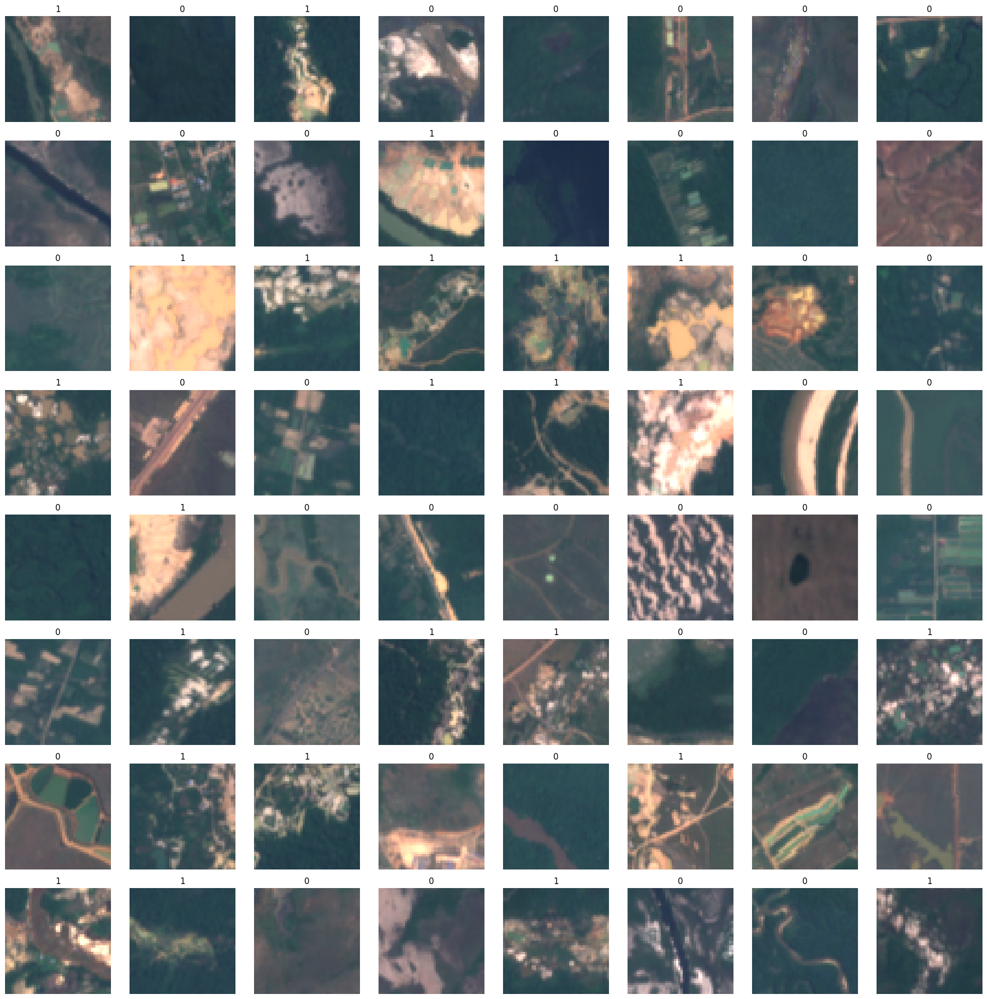

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

99.9% of data below brightness limit


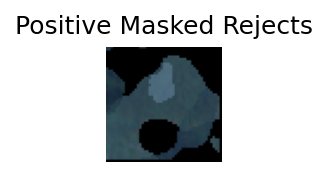

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7476666666666667].


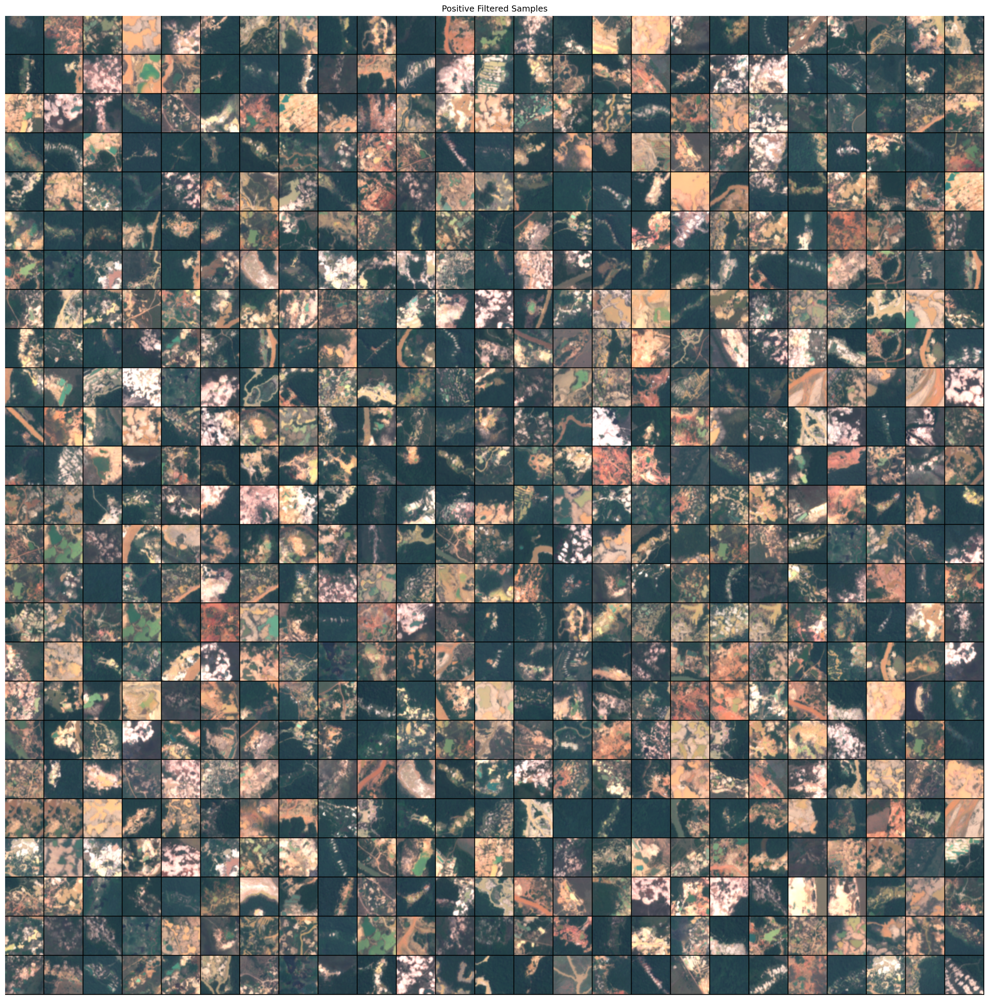

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.4073333333333333].


100.0% of data below brightness limit


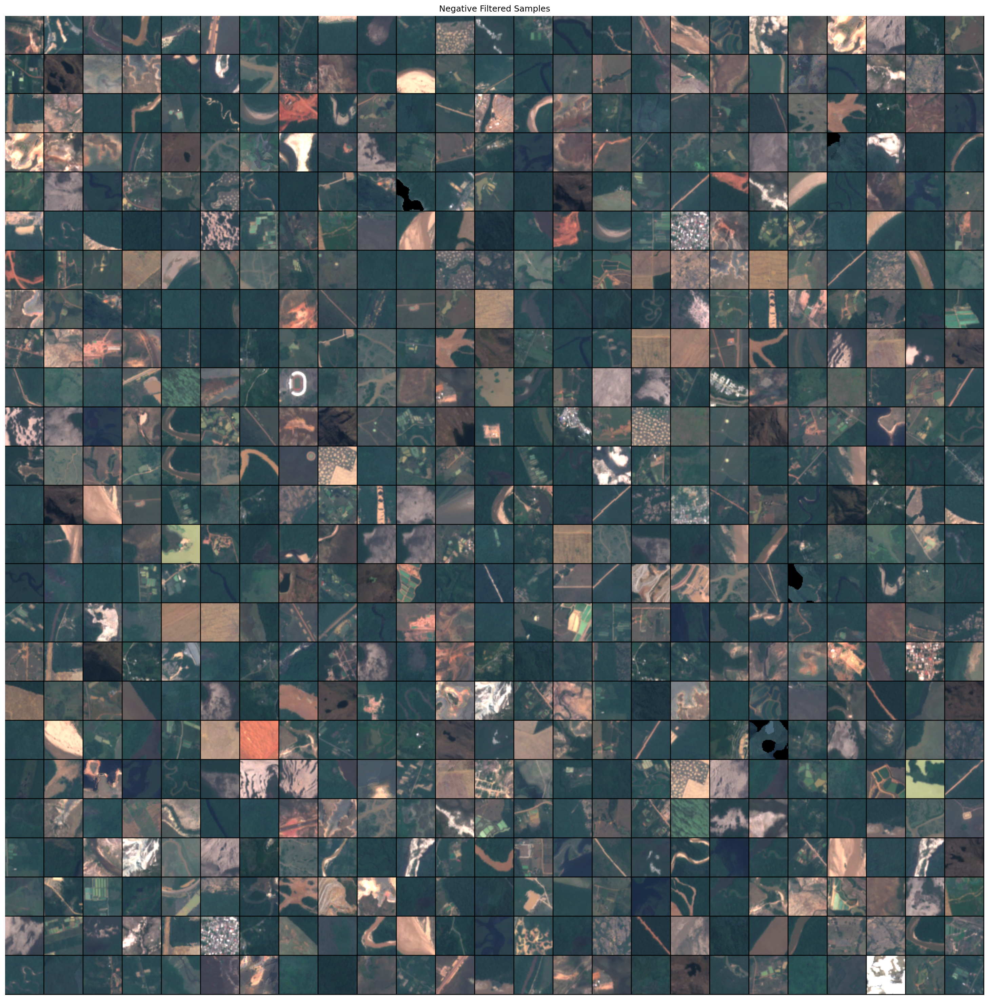

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

In [9]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

Seleccionamos el 10% del dataset para realizar el testeo de los modelos

In [10]:
dataset_size = len(y)
test_partition = int(dataset_size*0.1)

num_positive_samples_test = sum(y[:test_partition]==1)
num_negative_samples_test = sum(y[:test_partition]==0)

print(f"Número de clases positivas en el dataset de test {num_positive_samples_test}, número de clases negativas {num_negative_samples_test}")

x_norm = x_norm[:test_partition]
y = y[:test_partition]

Número de clases positivas en el dataset de test 185, número de clases negativas 269


# Seleccionar mejor modelo y parámetros para cada arquitectura

In [11]:
path_best_models = f"../notebooks/best_models"
paths_best_models = [path for path in os.listdir(path_best_models) if "modelo_y_parametros" not in path]

In [12]:
df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

for i,model in enumerate(["alexnet","scratch_modified","vgg16","mobile_net"]): 
    df_aux = pd.DataFrame()
    path_aux = ""
    for path in paths_best_models:
        for file in os.listdir(f"{path_best_models}/{path}"):
            if re.search(rf"{model}.*\.csv",file) is not None:
                df_aux, path_aux = dl_utils.compare_best_results(pd.read_csv(f"{path_best_models}/{path}/{file}"),df_aux,f"{path_best_models}/{path}/{file}",path_aux)
    if i == 0:
        df_alexnet = df_aux
        alexnet_best_path = path_aux
        alexnet_dir = "/".join(alexnet_best_path.split("/")[:-1])
    elif i== 1:
        df_scratch_modified = df_aux
        scratch_modified_best_path = path_aux
        scratch_modified_dir = "/".join(scratch_modified_best_path.split("/")[:-1])
    elif i == 2:
        df_vgg = df_aux
        vgg_best_path = path_aux
        vgg_dir = "/".join(vgg_best_path.split("/")[:-1])
    else:
        df_mobile_net = df_aux
        mobile_net_best_path = path_aux
        mobile_net_dir = "/".join(mobile_net_best_path.split("/")[:-1])

# Mejores resultados para el modelo original sin cambios en los hiperparámetros
path_dir_original  = [f"{path_best_models}/{path}" for path in os.listdir(path_best_models) if "modelo_y_parametros_originales" in path][0]
best_original_path = [ f"{path_dir_original}/{path_csv}" for path_csv in os.listdir(path_dir_original) if "csv" in path_csv][0]
df_original = pd.read_csv(best_original_path)
original_dir = "/".join(best_original_path.split("/")[:-1])

# Evaluación Test y muestreo de los mejores hiperparámetros, métricas y número de parámetros entrenables.

In [13]:
input_shape = (48,48,12)

## Modelo original con parámetros originales

../notebooks/best_models/modelo_y_parametros_originales_2024-09-25_18-14



2024-09-25 18:28:42.608744: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-25 18:28:42.697497: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-25 18:28:42.697538: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-25 18:28:42.699719: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-25 18:28:42.699754: I external/local_xla/xla/stream_executor

              precision    recall  f1-score   support

         0.0      0.947     0.989     0.967       269
         1.0      0.983     0.919     0.950       185

    accuracy                          0.960       454
   macro avg      0.965     0.954     0.958       454
weighted avg      0.961     0.960     0.960       454

Tiempo de inferencia medio: 0.146271 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "test_size": 0.3,
     "semilla": 1875
}

El número de épocas para training 	 ---> 160 épocas.

Tiempo total empleado en el entrenamiento --> 7 min 5 segundos 



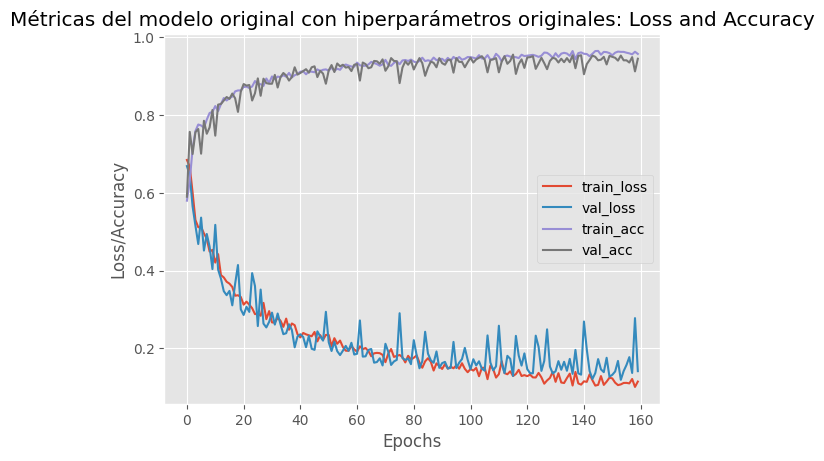


Número de parámetros entrenables

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)


In [14]:
print(f"{original_dir}\n")

tiempo_carga_inferencia = time.time()
modelo_y_parametros_originales = models.scratch_original_model(input_shape)
modelo_y_parametros_originales.load_weights(dl_utils.get_best_model_path(path_dir_original,"modelo_y_parametros_originales",".h5"))
inferencia = time.time()

for i in range(0,9):
    dl_utils.evaluate_model(modelo_y_parametros_originales,x_norm,y,False,"modelo_y_parametros_originales",False)

dl_utils.evaluate_model(modelo_y_parametros_originales,x_norm,y,False,"modelo_y_parametros_originales")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_modelo_y_parametros_originales,best_modelo_y_parametros_originales_results = dl_utils.load_hiperparams_and_results(original_dir,"modelo_y_parametros_originales")
print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_modelo_y_parametros_originales[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_modelo_y_parametros_originales[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_modelo_y_parametros_originales[-2])//60} min {round(hiperparams_modelo_y_parametros_originales[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_modelo_y_parametros_originales_results,"del modelo original con hiperparámetros originales", hiperparams_modelo_y_parametros_originales[-1])
print(f"\nNúmero de parámetros entrenables\n")
dl_utils.get_total_params(models.scratch_original_model(input_shape))

## AlexNet from scratch model

../notebooks/best_models/split_20_max_patience_2024-09-24_17-26

              precision    recall  f1-score   support

         0.0      0.950     0.989     0.969       269
         1.0      0.983     0.924     0.953       185

    accuracy                          0.963       454
   macro avg      0.966     0.957     0.961       454
weighted avg      0.963     0.963     0.962       454

Tiempo de inferencia medio: 0.156694 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 231
}

El número de épocas para training 	 ---> 82 épocas.

Tiempo total empleado en el entrenamiento --> 4 min 57 segundos 



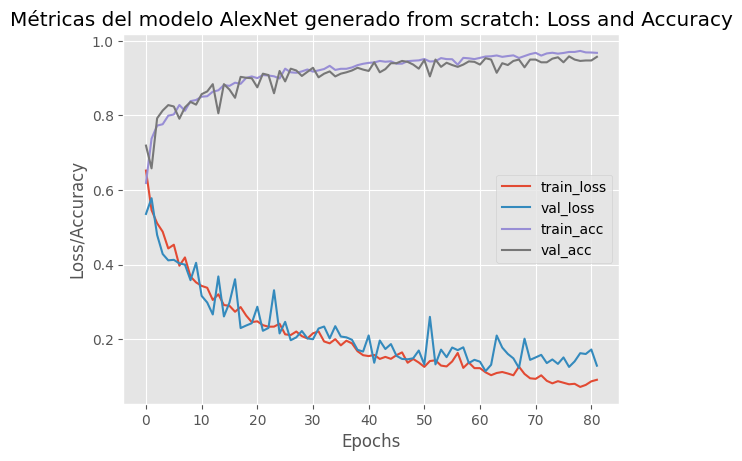


Número de parámetros entrenables

Total params: 10427873 (39.78 MB)
Trainable params: 10427873 (39.78 MB)
Non-trainable params: 0 (0.00 Byte)


In [15]:
print(f"{alexnet_dir}\n")

tiempo_carga_inferencia = time.time()
alexnet_model = models.alexnet_model(input_shape)
alexnet_model.load_weights(dl_utils.get_best_model_path(alexnet_dir,"alexnet",".h5"))
inferencia = time.time()

for i in range(0,9):
    dl_utils.evaluate_model(alexnet_model,x_norm,y,False,"alexnet",False)
    
dl_utils.evaluate_model(alexnet_model,x_norm,y,False,"alexnet")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_alexnet, metricas_alexnet = dl_utils.load_hiperparams_and_results(alexnet_dir,"alexnet")
print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_alexnet[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_alexnet[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_alexnet[-2])//60} min {round(hiperparams_alexnet[-2])%60} segundos \n")
dl_utils.grafica_accuracy(metricas_alexnet,"del modelo AlexNet generado from scratch",hiperparams_alexnet[-1])

print(f"\nNúmero de parámetros entrenables\n")
dl_utils.get_total_params(models.alexnet_model(input_shape))

## From scratch modified model (se aumenta el número de filtros del modelo original)

../notebooks/best_models/split_20_max_patience_2024-09-24_17-26

              precision    recall  f1-score   support

         0.0      0.974     0.989     0.982       269
         1.0      0.983     0.962     0.973       185

    accuracy                          0.978       454
   macro avg      0.979     0.976     0.977       454
weighted avg      0.978     0.978     0.978       454

Tiempo de inferencia medio: 0.120631 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 231
}

El número de épocas para training 	 ---> 127 épocas.

Tiempo total empleado en el entrenamiento --> 7 min 26 segundos 



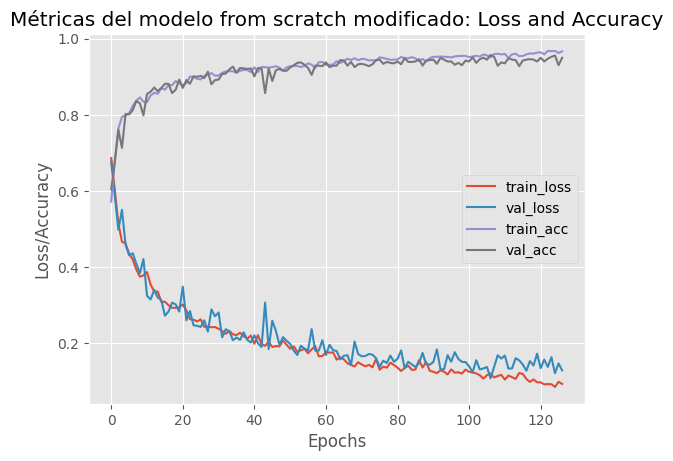


Número de parámetros entrenables

Total params: 1929281 (7.36 MB)
Trainable params: 1929281 (7.36 MB)
Non-trainable params: 0 (0.00 Byte)


In [16]:
print(f"{scratch_modified_dir}\n")

tiempo_carga_inferencia = time.time()
scratch_modified_model = models.scratch_modified_model(input_shape)
scratch_modified_model.load_weights(dl_utils.get_best_model_path(scratch_modified_dir,"scratch_modified",".h5"))
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(scratch_modified_model,x_norm,y,False,"scratch_modified_model",False)
    
dl_utils.evaluate_model(scratch_modified_model,x_norm,y,False,"scratch_modified_model")

tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_scratch_modified,best_scratch_modified_results = dl_utils.load_hiperparams_and_results(scratch_modified_dir,"scratch_modified")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_scratch_modified[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_scratch_modified[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_scratch_modified[-2])//60} min {round(hiperparams_scratch_modified[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_scratch_modified_results,"del modelo from scratch modificado",hiperparams_scratch_modified[-1])

print(f"\nNúmero de parámetros entrenables\n")
dl_utils.get_total_params(models.scratch_modified_model(input_shape))

## Fine-tunning con VGG16

../notebooks/best_models/split_20_max_patience_2024-09-24_17-26

              precision    recall  f1-score   support

         0.0      0.981     0.970     0.976       269
         1.0      0.957     0.973     0.965       185

    accuracy                          0.971       454
   macro avg      0.969     0.972     0.970       454
weighted avg      0.972     0.971     0.971       454

Tiempo de inferencia medio: 0.198254 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 0.8568438677270824,
          "1": 1.2005865102639297
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "test_size": 0.2,
     "semilla": 1880
}

El número de épocas para training 	 ---> 102 épocas.

Tiempo total empleado en el entrenamiento --> 6 min 8 segundos 



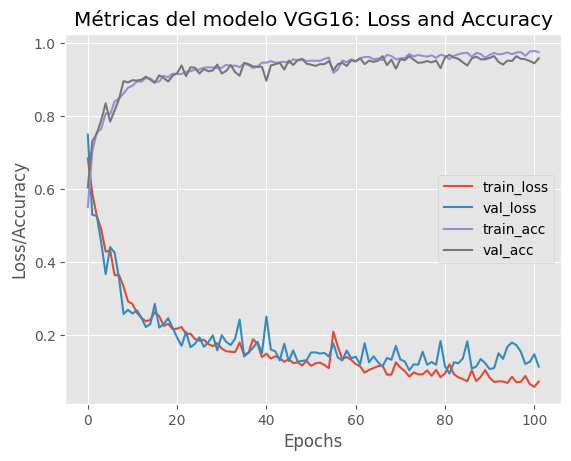


Número de parámetros entrenables

Total params: 15507841 (59.16 MB)
Trainable params: 8132737 (31.02 MB)
Non-trainable params: 7375104 (28.13 MB)


In [17]:
print(f"{vgg_dir}\n")

tiempo_carga_inferencia = time.time()
vgg16 = models.vgg_16_model(input_shape)
vgg16.load_weights(dl_utils.get_best_model_path(vgg_dir,"vgg16",".h5"))
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16",False)
    
dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_vgg,best_vgg_results = dl_utils.load_hiperparams_and_results(vgg_dir,"vgg16")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_vgg[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_vgg[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_vgg[-2])//60} min {round(hiperparams_vgg[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_vgg_results,"del modelo VGG16",hiperparams_vgg[-1])

print(f"\nNúmero de parámetros entrenables\n")
dl_utils.get_total_params(models.vgg_16_model(input_shape))

## Fine-tunning MobileNet

../notebooks/best_models/split_20_max_patience_2024-09-24_17-26

              precision    recall  f1-score   support

         0.0      0.985     0.955     0.970       269
         1.0      0.938     0.978     0.958       185

    accuracy                          0.965       454
   macro avg      0.961     0.967     0.964       454
weighted avg      0.966     0.965     0.965       454

Tiempo de inferencia medio es de: 0.113633 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 0.8568438677270824,
          "1": 1.2005865102639297
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 1538
}

El número de épocas para training 	 ---> 99 épocas.

Tiempo total empleado en el entrenamiento --> 6 min 1 segundos 



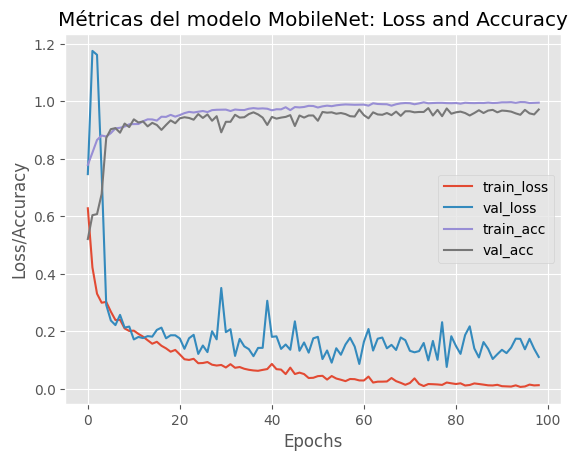


Número de parámetros entrenables

Total params: 4543745 (17.33 MB)
Trainable params: 3208193 (12.24 MB)
Non-trainable params: 1335552 (5.09 MB)


In [18]:
print(f"{mobile_net_dir}\n")

tiempo_carga_inferencia = time.time()
mobile_net = models.mobilenet_model(input_shape)
mobile_net.load_weights(dl_utils.get_best_model_path(mobile_net_dir,"mobile_net",".h5"))
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net",False)

dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net")
tiempo_inferencia = (time.time() - inferencia)/10

tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia medio es de: {tiempo_inferencia:.6f} segundos")

hiperparams_mobilenet,best_mobilenet_results = dl_utils.load_hiperparams_and_results(mobile_net_dir,"mobile_net")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_mobilenet[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_mobilenet[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_mobilenet[-2])//60} min {round(hiperparams_mobilenet[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_mobilenet_results,"del modelo MobileNet",hiperparams_mobilenet[-1])

print(f"\nNúmero de parámetros entrenables\n")
dl_utils.get_total_params(models.mobilenet_model(input_shape))